In [1]:
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import pandas as pd

from collections import defaultdict, OrderedDict
from common import *  # load_csv, normalize_df, env_ids, algo_names, load_total_dfs, normalizer, task_id_conv

In [2]:
total_dfs, errors = load_total_dfs(normalize=True)

/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[col] = normalized
/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[col] = normalized
/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `n

In [3]:

def get_result(env, mode, context):
    output_dfs = []
    for algo in algo_names:
        dfs = total_dfs[algo][env]
        for ind, df in enumerate(dfs):
            new_df = pd.DataFrame()
            new_df['Normalized Return'] = df[f'{mode}/{context}_normal_avg']
            new_df['Step'] = [1000*i for i in range(len(new_df))]
            new_df['seed'] = ind

            new_df['algo'] = f'\sc{{{algo.lower()}}}' 
            output_dfs.append(new_df)
    result = pd.concat(output_dfs)
    return result.reset_index()
        

<>:11: SyntaxWarning: invalid escape sequence '\s'
<>:11: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_27929/3969227317.py:11: SyntaxWarning: invalid escape sequence '\s'
  new_df['algo'] = f'\sc{{{algo.lower()}}}'


In [4]:
# PALETTE = {
#     "OfflinePearl": "#4daf4a",
#     "FOCAL": "#ff7f00",
#     "CSRO": "#984ea3",
#     "UNICORN": "#377eb8",
#     "MIR-GAN": "#e41a1c",
# }

def plot(mode, context):
    plt.rcParams["figure.dpi"] = 400
    plt.rcParams["font.size"] = 19
    plt.rcParams["legend.fontsize"] = 19
    plt.rcParams["legend.loc"] = "lower right"
    plt.rcParams["text.usetex"] = True
    
    ncol = 4
    nrow = 2
    fig, axs = plt.subplots(nrow, ncol, figsize=(4 * ncol, 3.5 * nrow))
    for idx, env in enumerate(env_ids):
        data = get_result(env, mode, context)
        row = idx // ncol
        col = idx % ncol
        ax = axs[row, col]
        if idx ==7:
            g = sns.lineplot(
                x="Step",
                y="Normalized Return",
                data=data,
                errorbar=("ci", 95),
                hue="algo",
                #palette=PALETTE,
                legend='auto',
                ax=ax,
            )
        else:
            g = sns.lineplot(
                x="Step",
                y="Normalized Return",
                data=data,
                errorbar=("ci", 95),
                hue="algo",
                #palette=PALETTE,
                legend=False,
                ax=ax,
            )
        ax.set_title(env_names[env])
    for ax_ in axs.flatten():
        ax_.set_xlabel("")
        ax_.set_ylabel("")
    for ax_ in axs[-1].flatten():
        ax_.set_xlabel("Train Steps")
    for ax_ in axs[:, 0].flatten():
        ax_.set_ylabel("Normalized Return")

    axs[-1, -1].legend(
        loc="upper center",
        bbox_to_anchor=(-1.6, -0.3),
        fancybox=False,
        shadow=False,
        ncol=5,
    )
    task = 'ID' if mode=='train' else 'OOD'
    fig.suptitle(f'{task} Tasks, {context.capitalize()} Context')
    plt.tight_layout()
    fig.subplots_adjust(bottom=0.1, wspace=0.33, hspace=0.43)
    # plt.savefig(f'plot_{mode}_{context}.pdf', bbox_inches='tight')
    plt.show()

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


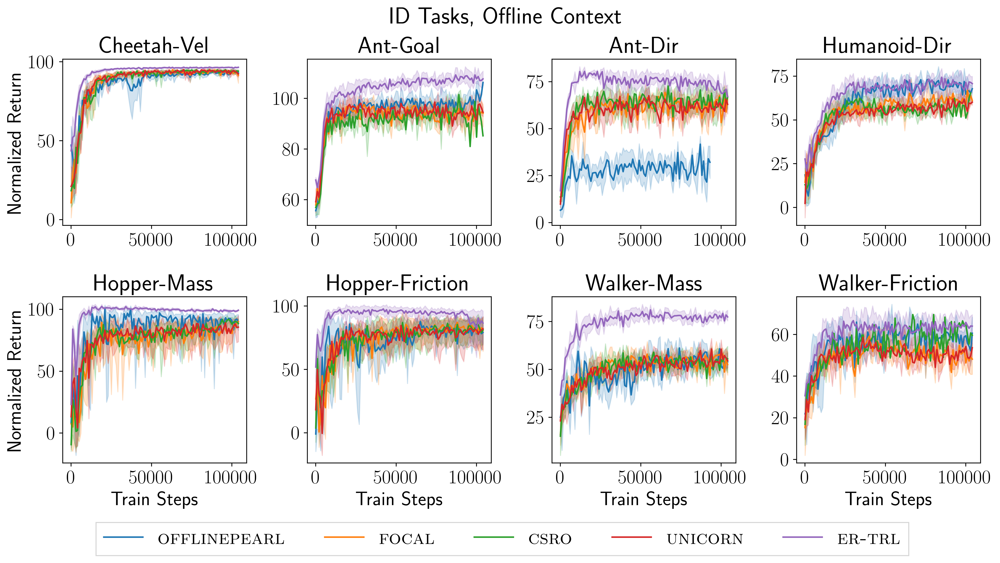

In [5]:
plot('train', 'offline')

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


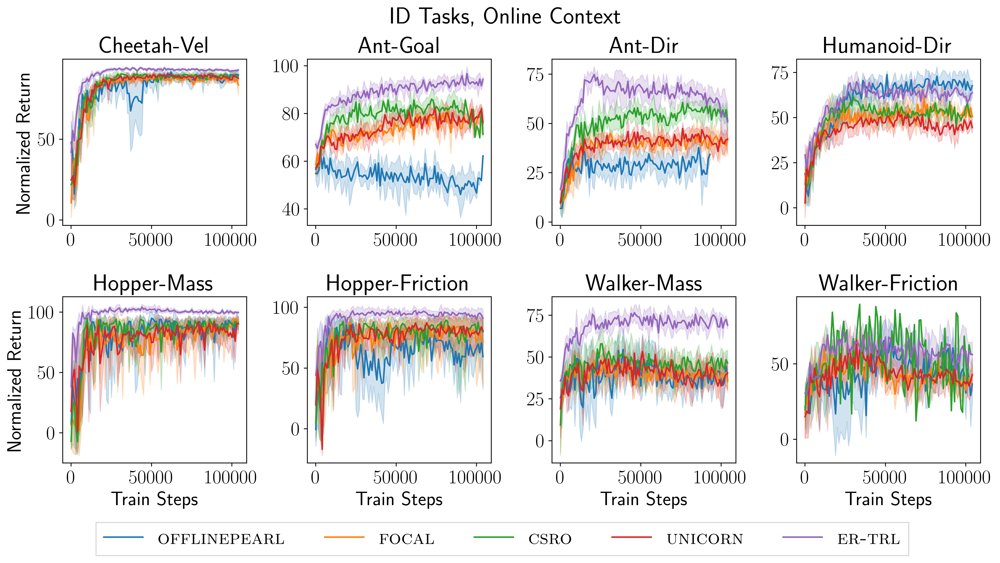

In [6]:
plot('train', 'online')

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


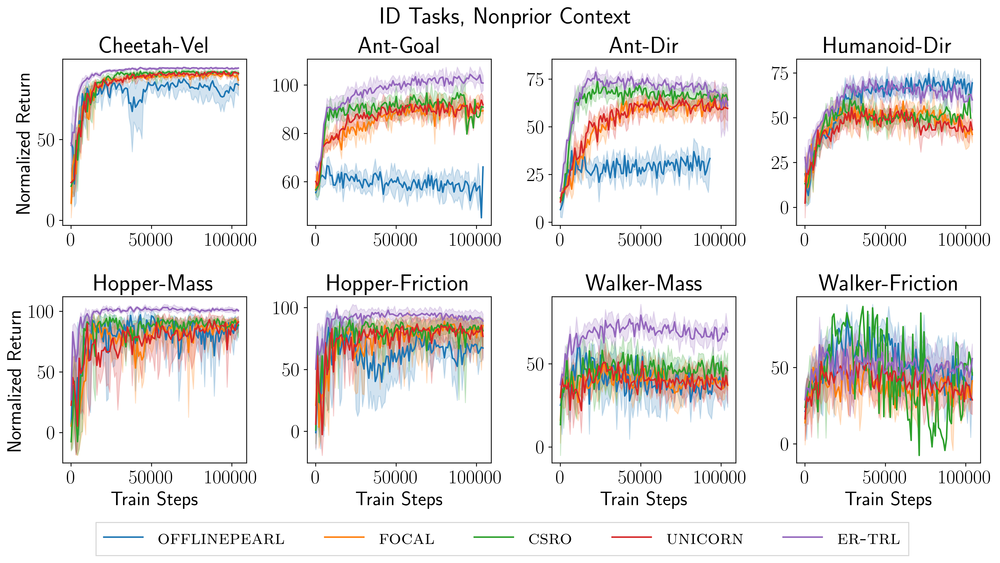

In [7]:
plot('train', 'nonprior')

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


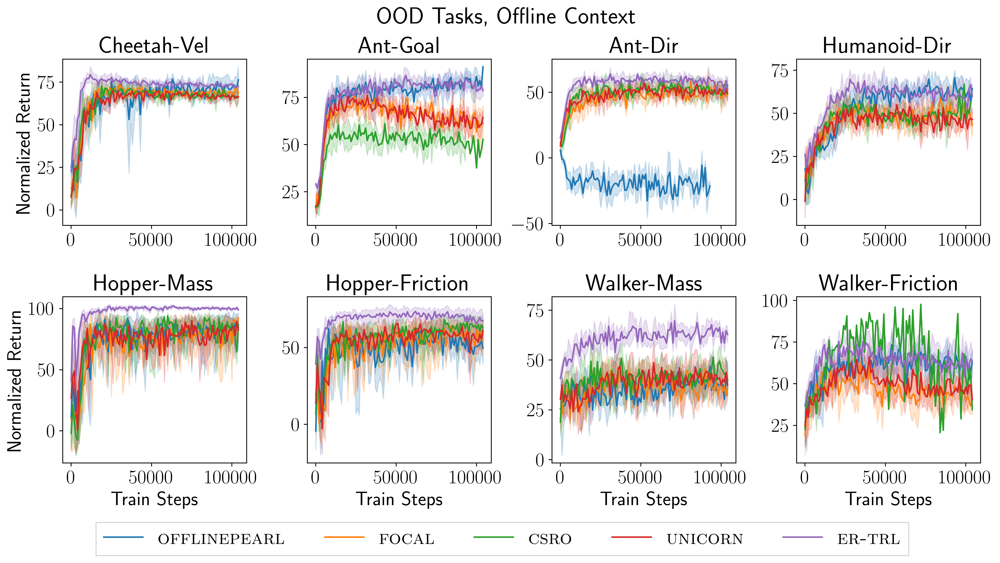

In [8]:
plot('moderate', 'offline')

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


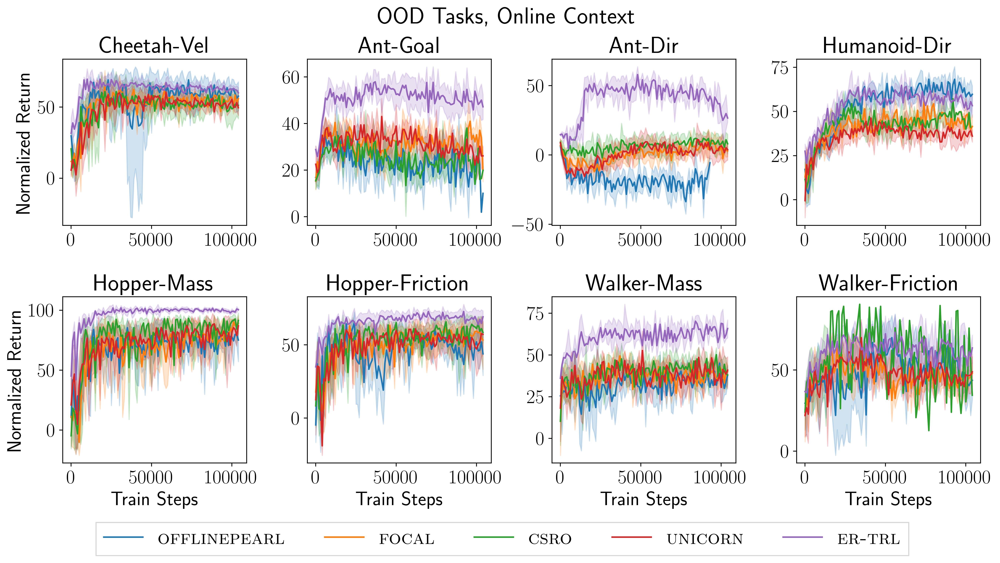

In [9]:
plot('moderate', 'online')

/tmp/ipykernel_27929/680508541.py:64: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


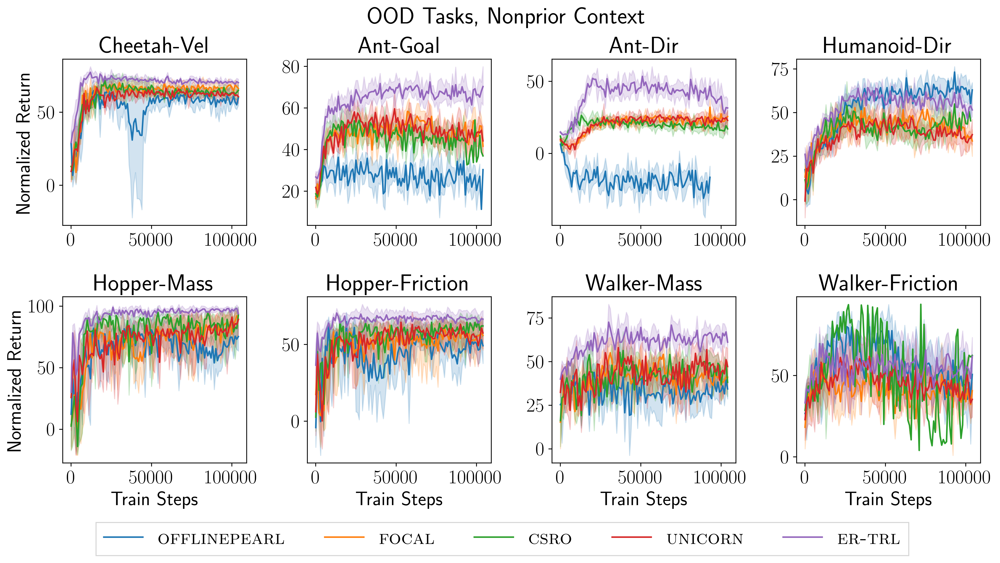

In [10]:
plot('moderate', 'nonprior')

## Ablation, distance metric learning

In [11]:
def load_ablation_dfs(n_seed=5, normalize=True):
    algo_names = ['ER-TRL', 'OnlyMI']
    env_ids = ['cheetah-vel-custom', 'ant-goal-custom', 'ant-dir-custom', 'hopper-mass', 'walker-friction']
    total_dfs = {}
    errors = []
    for algo in algo_names:
        total_dfs[algo] = {}
        for env in env_ids:
            result = []
            for seed in range(n_seed):
                try:
                    df = load_csv(algo=algo, env_id=env, seed=seed)
                    normalize_df(df, env_id=env, normalize=normalize)
                    result.append(df)
                except:
                    errors.append((env, algo, seed)) 
            total_dfs[algo][env] = result
    return total_dfs, errors

In [12]:
datas, errors = load_ablation_dfs()

/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[col] = normalized
/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[col] = normalized
/home/mrn/my_repos/mir-gan/scripts/common.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `n

In [13]:
errors

[('ant-dir-custom', 'ER-TRL', 3)]

In [14]:
def get_ablation_result(env, mode, context):
    algo_names = ['ER-TRL', 'OnlyMI']
    env_ids = ['cheetah-vel-custom', 'ant-goal-custom', 'ant-dir-custom', 'hopper-mass', 'walker-friction']
    output_dfs = []
    for algo in algo_names:
        dfs = datas[algo][env]
        for ind, df in enumerate(dfs):
            new_df = pd.DataFrame()
            new_df['Normalized Return'] = df[f'{mode}/{context}_normal_avg']
            new_df['Step'] = [1000*i for i in range(len(new_df))]
            new_df['seed'] = ind
            if 'ER' in algo:
                new_df['algo'] = '\sc{er-trl}'
            else:
                new_df['algo'] = '\sc{er-trl} w/o DML' 
            output_dfs.append(new_df)
    result = pd.concat(output_dfs)
    return result.reset_index()
        

<>:13: SyntaxWarning: invalid escape sequence '\s'
<>:15: SyntaxWarning: invalid escape sequence '\s'
<>:13: SyntaxWarning: invalid escape sequence '\s'
<>:15: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_27929/3923176244.py:13: SyntaxWarning: invalid escape sequence '\s'
  new_df['algo'] = '\sc{er-trl}'
/tmp/ipykernel_27929/3923176244.py:15: SyntaxWarning: invalid escape sequence '\s'
  new_df['algo'] = '\sc{er-trl} w/o DML'


/tmp/ipykernel_27929/186249403.py:59: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


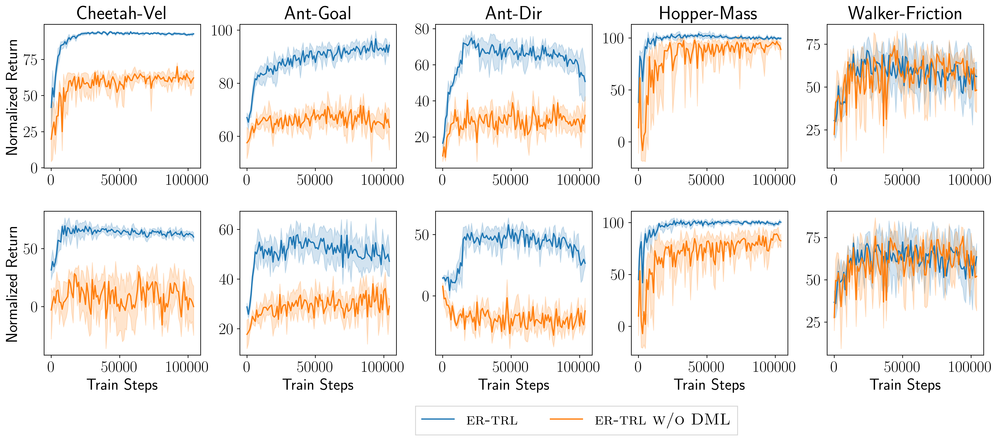

In [15]:
    plt.rcParams["figure.dpi"] = 400
    plt.rcParams["font.size"] = 19
    plt.rcParams["legend.fontsize"] = 19
    plt.rcParams["legend.loc"] = "lower right"
    plt.rcParams["text.usetex"] = True
    
    ncol = 5
    nrow = 2
    
    env_ids = ['cheetah-vel-custom', 'ant-goal-custom', 'ant-dir-custom', 'hopper-mass', 'walker-friction']
    context = 'online'
    fig, axs = plt.subplots(nrow, ncol, figsize=(4 * ncol, 3.5 * nrow))
    for row, mode in enumerate(['train', 'moderate',]):
        for idx, env in enumerate(env_ids):
            data = get_ablation_result(env, mode, context)
            col = idx 
            ax = axs[row, col]
            if idx ==(ncol-1) and row==(nrow-1):
                g = sns.lineplot(
                    x="Step",
                    y="Normalized Return",
                    data=data,
                    errorbar=("ci", 95),
                    hue="algo",
                    #palette=PALETTE,
                    legend='auto',
                    ax=ax,
                )
            else:
                g = sns.lineplot(
                    x="Step",
                    y="Normalized Return",
                    data=data,
                    errorbar=("ci", 95),
                    hue="algo",
                    #palette=PALETTE,
                    legend=False,
                    ax=ax,
                )
            if row==0:
                ax.set_title(env_names[env])
    for ax_ in axs.flatten():
        ax_.set_xlabel("")
        ax_.set_ylabel("")
    for ax_ in axs[-1].flatten():
        ax_.set_xlabel("Train Steps")
    for ax_ in axs[:, 0].flatten():
        ax_.set_ylabel("Normalized Return")

    axs[-1, -1].legend(
        loc="upper center",
        bbox_to_anchor=(-1.6, -0.3),
        fancybox=False,
        shadow=False,
        ncol=2,
    )
    # task = 'ID' if mode=='train' else 'OOD'
    # fig.suptitle(f'{task} Tasks, {context.capitalize()} Context')
    plt.tight_layout()
    fig.subplots_adjust(bottom=0.1, wspace=0.25, hspace=0.3)
    #plt.savefig(f'plot_ablation.pdf', bbox_inches='tight')
    plt.show()